In [20]:
import os
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import box
from matplotlib_scalebar.scalebar import ScaleBar
from shapely.geometry import Point

In [21]:
# Define root path for the Project directory
root_path = '/Users/mb6477/Desktop/ProbMod_project/COS-513-Group-Project/'

# Load all NOAA storm data CSV files 
noaa_dir = os.path.join(root_path, 'data/NOAA_STORM_DATA')
df_noaa = pd.concat([pd.read_csv(os.path.join(noaa_dir, f)) for f in os.listdir(noaa_dir)])

# Remove records with missing state FIPS codes 
df_noaa = (df_noaa.dropna(subset=['STATE_FIPS', 'BEGIN_LON', 'BEGIN_LAT'])
           .assign(
               STATE_FIPS=lambda x: x['STATE_FIPS'].astype(int).astype(str).str.zfill(2),
               CZ_FIPS=lambda x: x['CZ_FIPS'].astype(int).astype(str).str.zfill(3)))

/var/folders/p3/9thmbny930lcn8vcx6g216br0000gp/T/ipykernel_49800/3602676798.py:6: DtypeWarning: Columns (26,28) have mixed types. Specify dtype option on import or set low_memory=False.
  df_noaa = pd.concat([pd.read_csv(os.path.join(noaa_dir, f)) for f in os.listdir(noaa_dir)])
/var/folders/p3/9thmbny930lcn8vcx6g216br0000gp/T/ipykernel_49800/3602676798.py:6: DtypeWarning: Columns (29,34,35,37) have mixed types. Specify dtype option on import or set low_memory=False.
  df_noaa = pd.concat([pd.read_csv(os.path.join(noaa_dir, f)) for f in os.listdir(noaa_dir)])
/var/folders/p3/9thmbny930lcn8vcx6g216br0000gp/T/ipykernel_49800/3602676798.py:6: DtypeWarning: Columns (28) have mixed types. Specify dtype option on import or set low_memory=False.
  df_noaa = pd.concat([pd.read_csv(os.path.join(noaa_dir, f)) for f in os.listdir(noaa_dir)])
/var/folders/p3/9thmbny930lcn8vcx6g216br0000gp/T/ipykernel_49800/3602676798.py:6: DtypeWarning: Columns (28) have mixed types. Specify dtype option on import

In [22]:
df_filtered = (
    df_noaa.dropna(subset=['STATE_FIPS', 'CZ_FIPS', 'BEGIN_LON', 'BEGIN_LAT'])
    .assign(
        YEAR=lambda x: x['BEGIN_YEARMONTH'].astype(str).str[:4].astype(int),
        STATE_FIPS=lambda x: x['STATE_FIPS'].astype(int).astype(str).str.zfill(2),
        CZ_FIPS=lambda x: x['CZ_FIPS'].astype(int).astype(str).str.zfill(3)
    )
    .query('2000 <= YEAR <= 2024')
)

df_noaa=df_filtered

In [23]:
# Identify the ten most frequent storm event types in the dataset for focused analysis
top_ten_events = (df_noaa['EVENT_TYPE'].value_counts().head(30).index.tolist())
print('Top 10 events since 2000:', top_ten_events)

# Filter the DataFrame to include only records corresponding to the top ten event types
df_top_events = df_noaa[df_noaa['EVENT_TYPE'].isin(top_ten_events)]

# Convert the filtered DataFrame to a GeoDataFrame with point geometries based on event coordinates
gdf_storms = gpd.GeoDataFrame(
    df_top_events,
    geometry=gpd.points_from_xy(df_top_events['BEGIN_LON'], df_top_events['BEGIN_LAT']),
    crs='EPSG:4326')

Top 10 events since 2000: ['Thunderstorm Wind', 'Hail', 'Flash Flood', 'Flood', 'Marine Thunderstorm Wind', 'Tornado', 'Heavy Rain', 'Lightning', 'Funnel Cloud', 'Waterspout', 'Debris Flow', 'Marine High Wind', 'Marine Hail', 'Marine Strong Wind', 'Dust Devil', 'High Wind', 'Drought', 'Strong Wind', 'Dust Storm', 'Storm Surge/Tide', 'Tropical Storm', 'Marine Lightning', 'Dense Fog', 'Heat']


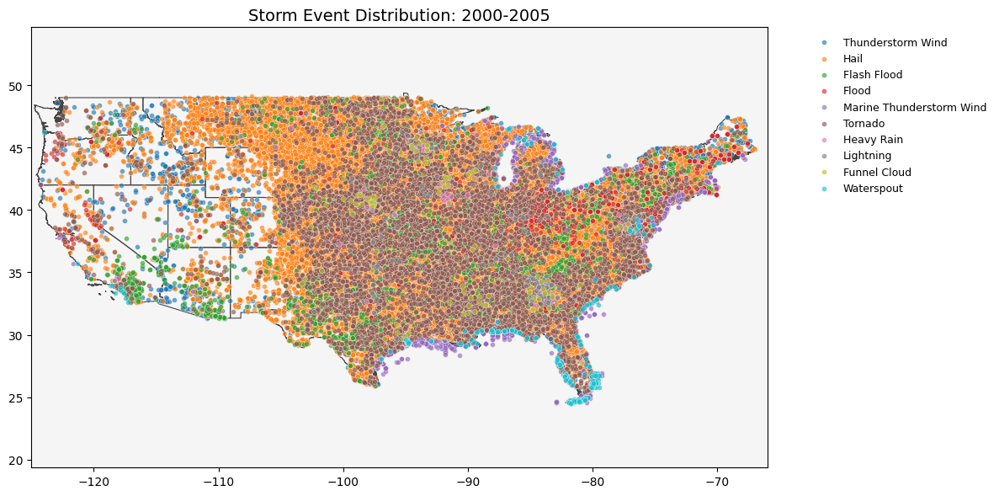

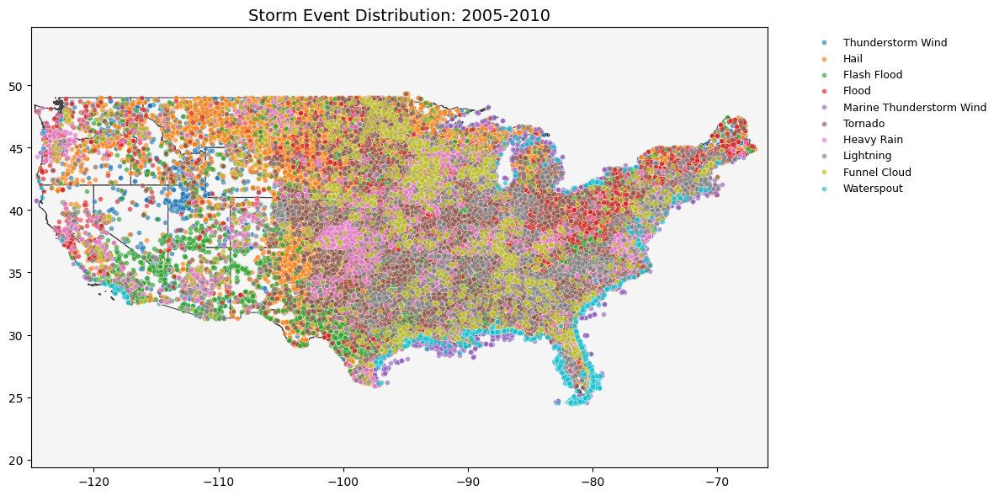

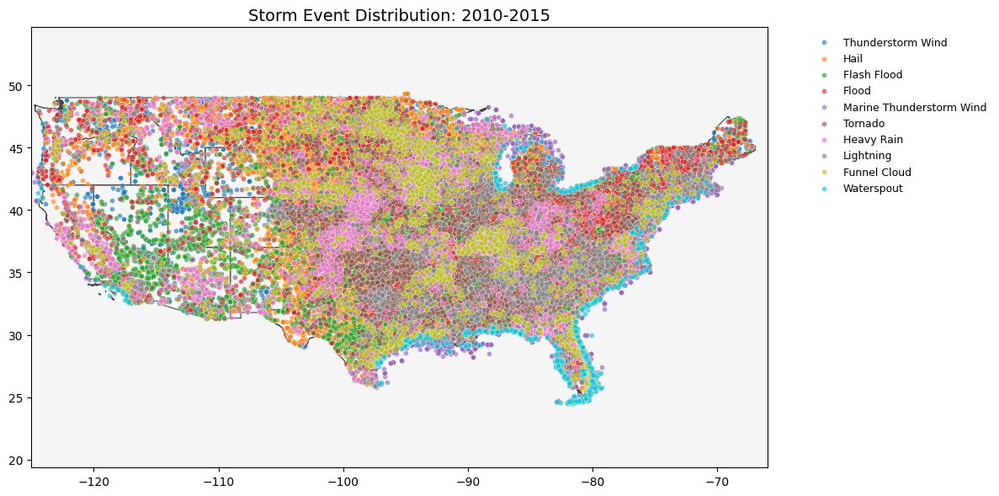

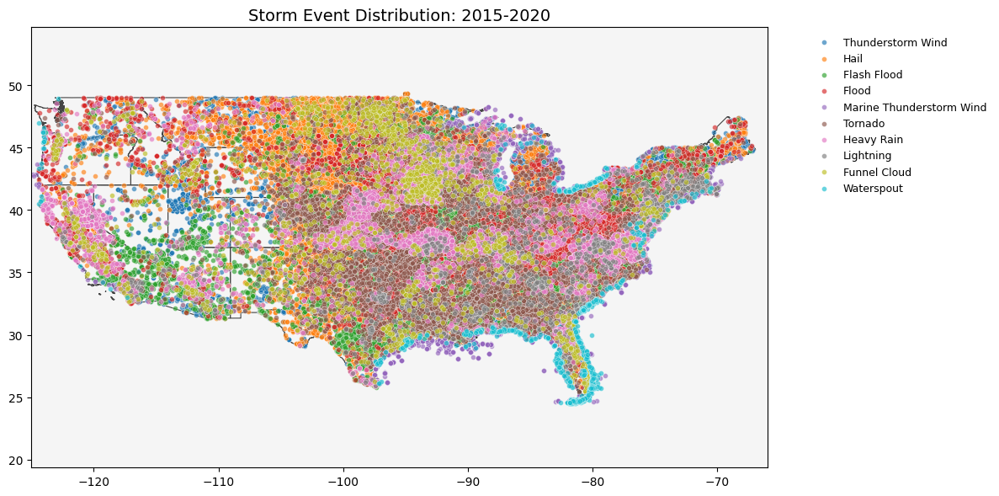

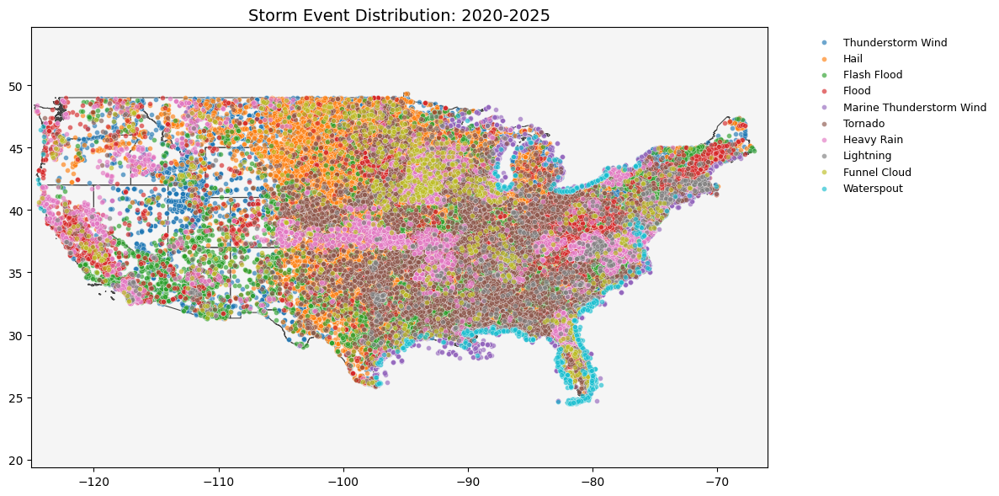

In [5]:
# Define the bounding box for the contiguous United States (CONUS) in WGS84 coordinates
CONUS_BBOX = (-125, 24.5, -66, 49.5)

# Create a GeoDataFrame representing the CONUS bounding box for spatial filtering
conus_mask = gpd.GeoDataFrame(geometry=[box(*CONUS_BBOX)], crs='EPSG:4326')

# Use a spatial join to retain only storm events that fall within the CONUS bounding box
gdf_storms = gpd.sjoin(gdf_storms, conus_mask, predicate='within').drop(columns=['index_right'])

# Load the shapefile containing US state boundaries and filter to include only the lower 48 states and DC
states = gpd.read_file(os.path.join(root_path, 'data/s_05mr24/s_05mr24.shp'), engine='pyogrio')
conus_states = states[~states['STATE'].isin(['AK', 'HI', 'PR'])].cx[CONUS_BBOX[0]:CONUS_BBOX[2], CONUS_BBOX[1]:CONUS_BBOX[3]]

# Extract the year from the BEGIN_YEARMONTH column
gdf_storms['Year'] = gdf_storms['BEGIN_YEARMONTH'].astype(str).str[:4].astype(int)

# Define the range of years for analysis, using 5-year intervals
year_range = range(gdf_storms['Year'].min(), gdf_storms['Year'].max() + 1, 5)

# For each 5-year interval, plot the spatial distribution of the top ten storm event types across the CONUS
for start_year in year_range:
    end_year = start_year + 5
    # Select storm events that occurred within the current 5-year interval
    period_data = gdf_storms.query(f'{start_year} <= Year <= {end_year}')
    if period_data.empty:
        continue

    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot the boundaries of CONUS states as the basemap 
    conus_states.boundary.plot(ax=ax, linewidth=0.8, edgecolor='#444444', zorder=1)

    # Plot storm events for each event type, using distinct markers and colors for clarity
    for event_type in top_ten_events:
        event_data = period_data[period_data['EVENT_TYPE'] == event_type]
        if not event_data.empty:
            event_data.plot(
                ax=ax, label=event_type, markersize=18,
                alpha=0.65, edgecolor='w', linewidth=0.3,
                zorder=2
            )

    # Set the map extent to the CONUS bounding box and ensure equal aspect ratio 
    ax.set_xlim(CONUS_BBOX[0], CONUS_BBOX[2])
    ax.set_ylim(CONUS_BBOX[1], CONUS_BBOX[3])
    ax.set_aspect('equal', adjustable='datalim')
    ax.set_facecolor('#f5f5f5')

    # Add title and legend, and optimize the layout
    plt.title(f'Storm Event Distribution: {start_year}-{end_year}', fontsize=14)
    plt.legend(bbox_to_anchor=(1.05, 1), frameon=False, fontsize=9)
    plt.tight_layout()
    plt.show()


In [6]:
# Calculate dx for WGS84 coordinates at mid latitude
mid_lat = 37  # Average CONUS latitude
points = gpd.GeoSeries(
    [Point(-125, mid_lat), Point(-124, mid_lat)], 
    crs='EPSG:4326'
).to_crs(epsg=32611)  # UTM zone 11N for metric distance
dx = points[0].distance(points[1])  # meters per degree longitude

In [7]:
# Create a unique county identifier by concatenating STATE_FIPS and CZ_FIPS
df_noaa['COUNTY_ID'] = df_noaa['STATE_FIPS'] + df_noaa['CZ_FIPS']

# Display the first few rows to verify the new column
print(df_noaa[['STATE_FIPS', 'CZ_FIPS', 'COUNTY_ID']].head())

  STATE_FIPS CZ_FIPS COUNTY_ID
0         31     069     31069
1         31     161     31161
2         31     161     31161
3         50     011     50011
4         50     015     50015


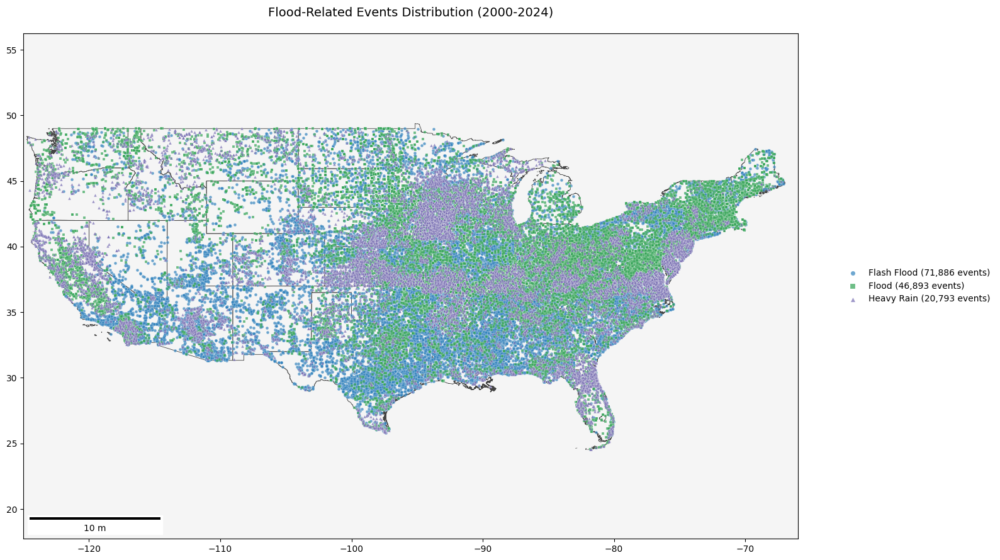

In [8]:
# Configure plot parameters
CONUS_BBOX = (-125, 24.5, -66, 49.5)
EVENT_TYPES = ['Flash Flood', 'Flood', 'Heavy Rain']
COLORS = ['#3182bd', '#31a354', '#756bb1']  # Distinct colors for each event type
MARKERS = ['o', 's', '^']  # Circle, Square, Triangle

# Create base map
fig, ax = plt.subplots(figsize=(16, 9))
conus_states.boundary.plot(ax=ax, linewidth=0.6, edgecolor='#444444', zorder=1)

# Filter and plot 2000-2024 data
period_data = gdf_storms[
    (gdf_storms['Year'].between(2000, 2024)) &
    (gdf_storms['EVENT_TYPE'].isin(EVENT_TYPES))
]

# Plot each event type with distinct styling
for idx, event_type in enumerate(EVENT_TYPES):
    event_data = period_data[period_data['EVENT_TYPE'] == event_type]
    if not event_data.empty:
        event_data.plot(
            ax=ax,
            markersize=12,
            alpha=0.7,
            color=COLORS[idx],
            marker=MARKERS[idx],
            edgecolor='w',
            linewidth=0.2,
            label=f'{event_type} ({len(event_data):,} events)',
            zorder=2
        )

# Configure map aesthetics
ax.set_xlim(CONUS_BBOX[0], CONUS_BBOX[2])
ax.set_ylim(CONUS_BBOX[1], CONUS_BBOX[3])
ax.set_aspect('equal', adjustable='datalim')
ax.set_facecolor('#f5f5f5')

# Add map elements
plt.title('Flood-Related Events Distribution (2000-2024)', fontsize=14, pad=20)
plt.legend(
    bbox_to_anchor=(1.05, 0.5),
    loc='center left',
    frameon=False,
    fontsize=10,
    markerscale=1.5
)

# Add scale bar
ax.add_artist(ScaleBar(
    dx=1, 
    location='lower left',
    length_fraction=0.25,
    height_fraction=0.005,
    border_pad=0.5
))

plt.tight_layout()
plt.show()


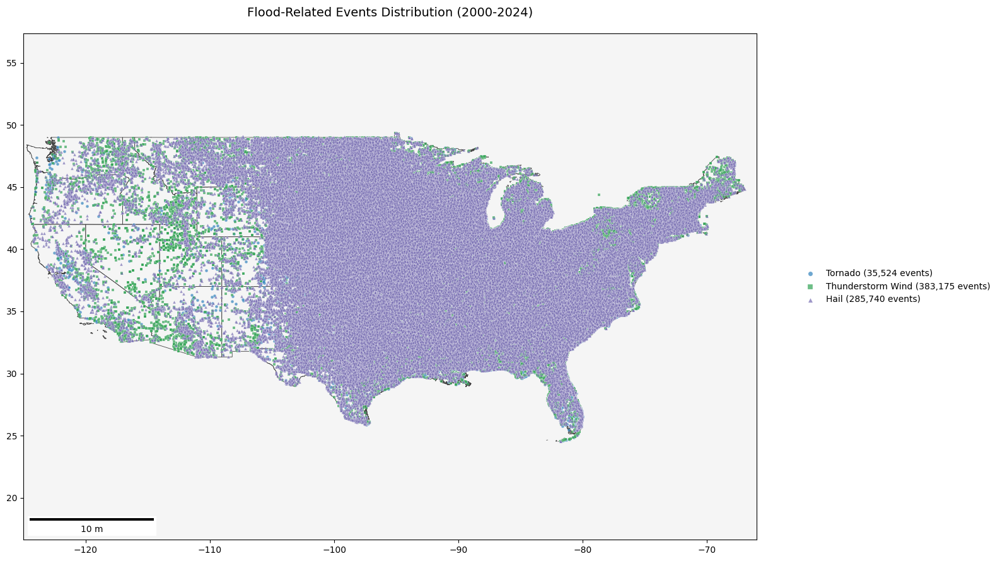

In [9]:
# Configure plot parameters
CONUS_BBOX = (-125, 24.5, -66, 49.5)
EVENT_TYPES = ['Tornado', 'Thunderstorm Wind', 'Hail']
COLORS = ['#3182bd', '#31a354', '#756bb1']  # Distinct colors for each event type
MARKERS = ['o', 's', '^']  # Circle, Square, Triangle

# Create base map
fig, ax = plt.subplots(figsize=(16, 9))
conus_states.boundary.plot(ax=ax, linewidth=0.6, edgecolor='#444444', zorder=1)

# Filter and plot 2000-2024 data
period_data = gdf_storms[
    (gdf_storms['Year'].between(2000, 2024)) &
    (gdf_storms['EVENT_TYPE'].isin(EVENT_TYPES))
]

# Plot each event type with distinct styling
for idx, event_type in enumerate(EVENT_TYPES):
    event_data = period_data[period_data['EVENT_TYPE'] == event_type]
    if not event_data.empty:
        event_data.plot(
            ax=ax,
            markersize=12,
            alpha=0.7,
            color=COLORS[idx],
            marker=MARKERS[idx],
            edgecolor='w',
            linewidth=0.2,
            label=f'{event_type} ({len(event_data):,} events)',
            zorder=2
        )

# Configure map aesthetics
ax.set_xlim(CONUS_BBOX[0], CONUS_BBOX[2])
ax.set_ylim(CONUS_BBOX[1], CONUS_BBOX[3])
ax.set_aspect('equal', adjustable='datalim')
ax.set_facecolor('#f5f5f5')

# Add map elements
plt.title('Flood-Related Events Distribution (2000-2024)', fontsize=14, pad=20)
plt.legend(
    bbox_to_anchor=(1.05, 0.5),
    loc='center left',
    frameon=False,
    fontsize=10,
    markerscale=1.5
)

# Add scale bar
ax.add_artist(ScaleBar(
    dx=1, 
    location='lower left',
    length_fraction=0.25,
    height_fraction=0.005,
    border_pad=0.5
))

plt.tight_layout()
plt.show()


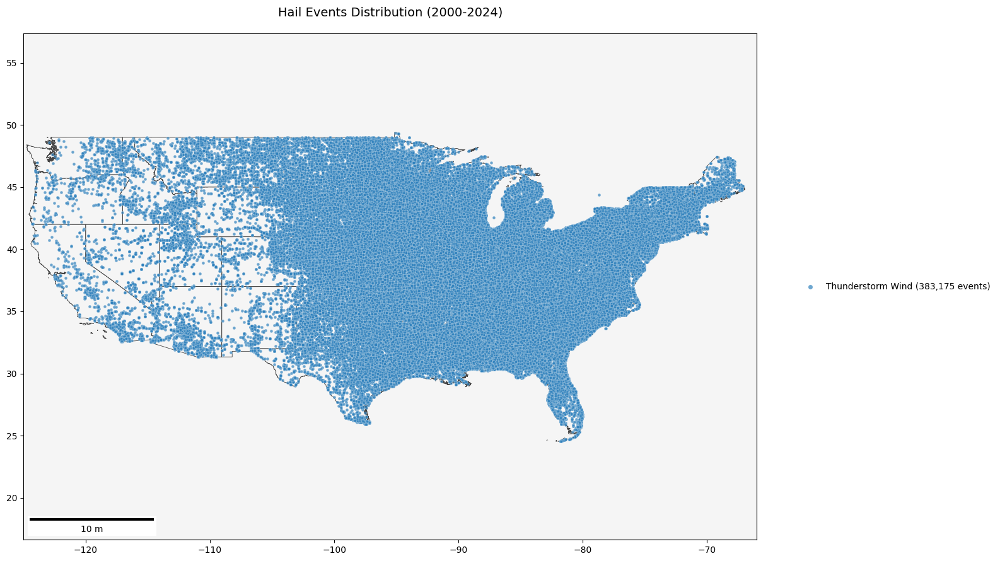

In [10]:
# Configure plot parameters
CONUS_BBOX = (-125, 24.5, -66, 49.5)
EVENT_TYPES = ['Thunderstorm Wind']
COLORS = ['#3182bd', '#31a354', '#756bb1']  # Distinct colors for each event type
MARKERS = ['o', 's', '^']  # Circle, Square, Triangle

# Create base map
fig, ax = plt.subplots(figsize=(16, 9))
conus_states.boundary.plot(ax=ax, linewidth=0.6, edgecolor='#444444', zorder=1)

# Filter and plot 2000-2024 data
period_data = gdf_storms[
    (gdf_storms['Year'].between(2000, 2024)) &
    (gdf_storms['EVENT_TYPE'].isin(EVENT_TYPES))
]

# Plot each event type with distinct styling
for idx, event_type in enumerate(EVENT_TYPES):
    event_data = period_data[period_data['EVENT_TYPE'] == event_type]
    if not event_data.empty:
        event_data.plot(
            ax=ax,
            markersize=12,
            alpha=0.7,
            color=COLORS[idx],
            marker=MARKERS[idx],
            edgecolor='w',
            linewidth=0.2,
            label=f'{event_type} ({len(event_data):,} events)',
            zorder=2
        )

# Configure map aesthetics
ax.set_xlim(CONUS_BBOX[0], CONUS_BBOX[2])
ax.set_ylim(CONUS_BBOX[1], CONUS_BBOX[3])
ax.set_aspect('equal', adjustable='datalim')
ax.set_facecolor('#f5f5f5')

# Add map elements
plt.title('Hail Events Distribution (2000-2024)', fontsize=14, pad=20)
plt.legend(
    bbox_to_anchor=(1.05, 0.5),
    loc='center left',
    frameon=False,
    fontsize=10,
    markerscale=1.5
)

# Add scale bar
ax.add_artist(ScaleBar(
    dx=1, 
    location='lower left',
    length_fraction=0.25,
    height_fraction=0.005,
    border_pad=0.5
))

plt.tight_layout()
plt.show()


In [11]:
# Construct full path to county shapefile
county_path = os.path.join(root_path, 'data/s_05mr24/tl_2024_us_county/tl_2024_us_county.shp')

# Verify file exists before loading
if not os.path.exists(county_path):
    raise FileNotFoundError(f"County shapefile not found at: {county_path}")

# Load county data with pyogrio engine
counties = gpd.read_file(county_path, engine='pyogrio')

# Confirm successful load
print("County data columns:", counties.columns.tolist())
counties.head()

County data columns: ['STATEFP', 'COUNTYFP', 'COUNTYNS', 'GEOID', 'GEOIDFQ', 'NAME', 'NAMELSAD', 'LSAD', 'CLASSFP', 'MTFCC', 'CSAFP', 'CBSAFP', 'METDIVFP', 'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'geometry']


,STATEFP,COUNTYFP,COUNTYNS,GEOID,GEOIDFQ,NAME,NAMELSAD,LSAD,CLASSFP,MTFCC,CSAFP,CBSAFP,METDIVFP,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,31,039,00835841,31039,0500000US31039,Cuming,Cuming County,06,H1,G4020,None,None,None,A,1477563042,10772508,+41.9158651,-096.7885168,"POLYGON ((-96.55525 41.82892, -96.55524 41.827..."
1,53,069,01513275,53069,0500000US53069,Wahkiakum,Wahkiakum County,06,H1,G4020,None,None,None,A,680980773,61564428,+46.2946377,-123.4244583,"POLYGON ((-123.72755 46.26449, -123.72755 46.2..."
2,35,011,00933054,35011,0500000US35011,De Baca,De Baca County,06,H1,G4020,None,None,None,A,6016818941,29090018,+34.3592729,-104.3686961,"POLYGON ((-104.89337 34.08894, -104.89337 34.0..."
3,31,109,00835876,31109,0500000US31109,Lancaster,Lancaster County,06,H1,G4020,339,30700,None,A,2169269508,22850511,+40.7835474,-096.6886584,"POLYGON ((-96.68493 40.52330, -96.69219 40.523..."
4,31,129,00835886,31129,0500000US31129,Nuckolls,Nuckolls County,06,H1,G4020,None,None,None,A,1489645201,1718484,+40.1764918,-098.0468422,"POLYGON ((-98.27370 40.11840, -98.27374 40.122..."


## Looking at 3 specific events - Flash Flood, Flood, Heavy Rain

In [13]:
selected_events = ['Flash Flood', 'Flood', 'Heavy Rain']
df_selected = df_noaa[df_noaa['EVENT_TYPE'].isin(selected_events)].copy()
variables = list(df_selected.columns)
print(variables)

['BEGIN_YEARMONTH', 'BEGIN_DAY', 'BEGIN_TIME', 'END_YEARMONTH', 'END_DAY', 'END_TIME', 'EPISODE_ID', 'EVENT_ID', 'STATE', 'STATE_FIPS', 'YEAR', 'MONTH_NAME', 'EVENT_TYPE', 'CZ_TYPE', 'CZ_FIPS', 'CZ_NAME', 'WFO', 'BEGIN_DATE_TIME', 'CZ_TIMEZONE', 'END_DATE_TIME', 'INJURIES_DIRECT', 'INJURIES_INDIRECT', 'DEATHS_DIRECT', 'DEATHS_INDIRECT', 'DAMAGE_PROPERTY', 'DAMAGE_CROPS', 'SOURCE', 'MAGNITUDE', 'MAGNITUDE_TYPE', 'FLOOD_CAUSE', 'CATEGORY', 'TOR_F_SCALE', 'TOR_LENGTH', 'TOR_WIDTH', 'TOR_OTHER_WFO', 'TOR_OTHER_CZ_STATE', 'TOR_OTHER_CZ_FIPS', 'TOR_OTHER_CZ_NAME', 'BEGIN_RANGE', 'BEGIN_AZIMUTH', 'BEGIN_LOCATION', 'END_RANGE', 'END_AZIMUTH', 'END_LOCATION', 'BEGIN_LAT', 'BEGIN_LON', 'END_LAT', 'END_LON', 'EPISODE_NARRATIVE', 'EVENT_NARRATIVE', 'DATA_SOURCE', 'COUNTY_ID']


In [14]:
# Extract the year from BEGIN_YEARMONTH (first 4 digits)
years = df_selected['BEGIN_YEARMONTH'].astype(str).str[:4].astype(int)
year_min = years.min()
year_max = years.max()
print(f"Year range: {year_min} to {year_max}")


Year range: 2001 to 2024


In [15]:
#df_selected.head()

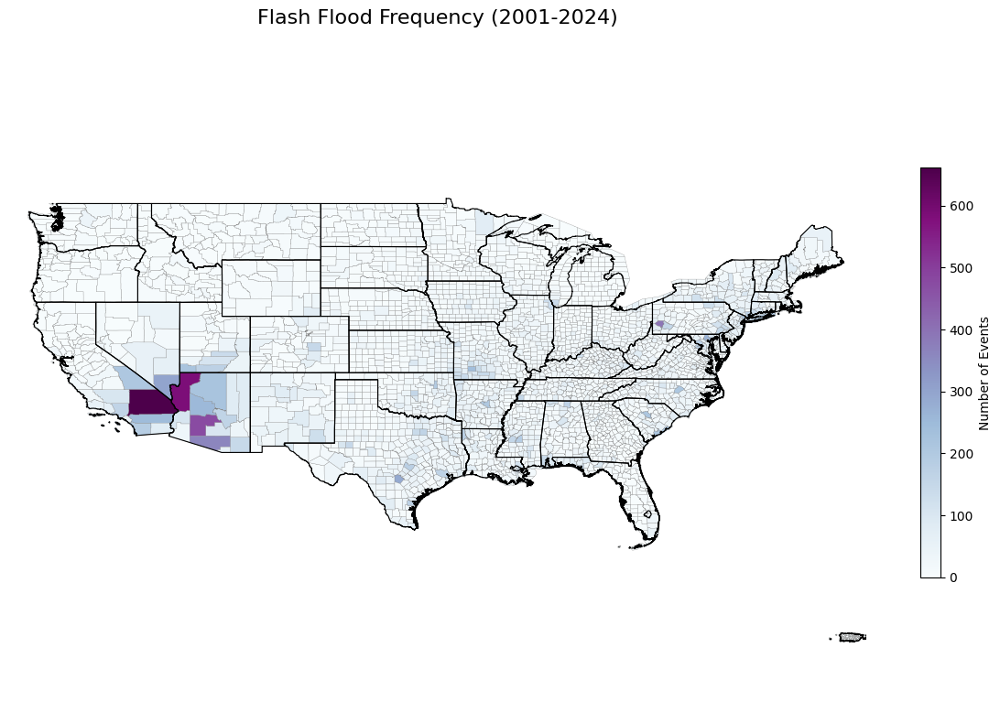

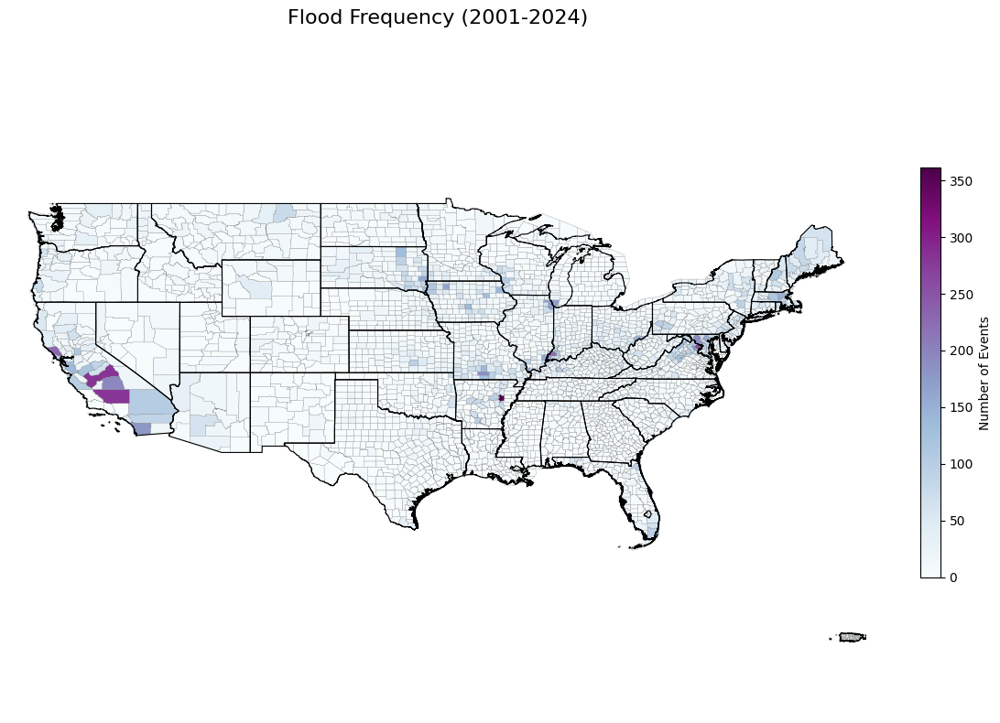

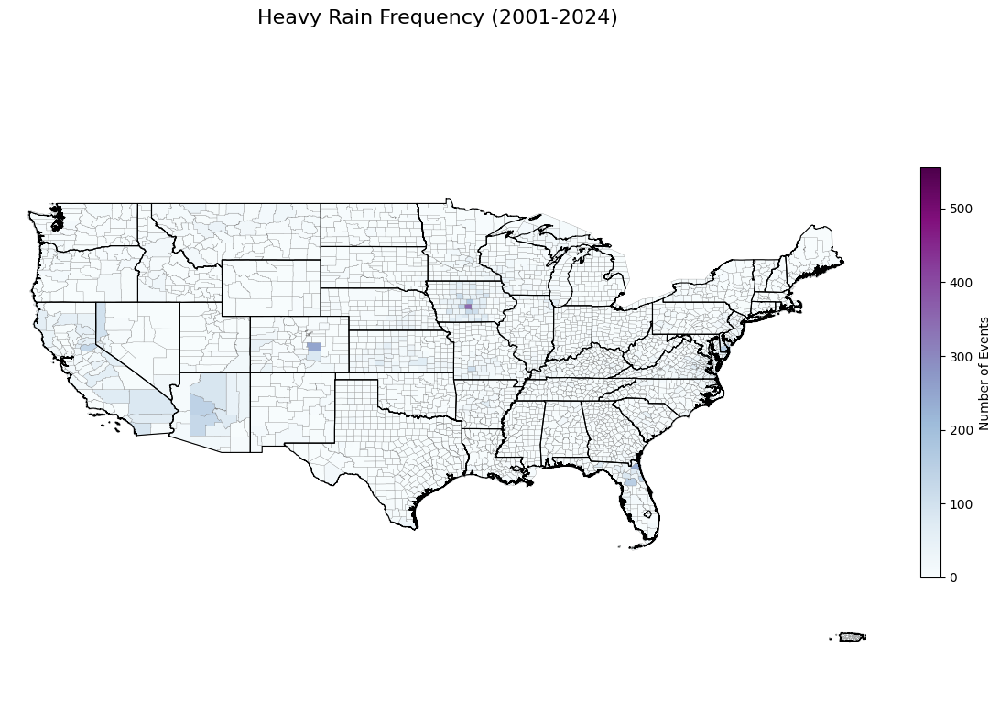

In [18]:
# County shapefile
county_fp = "data/tl_2019_us_county/tl_2019_us_county.shp"
gdf_county = gpd.read_file(county_fp)

# State shapefile
state_fp = "data/s_05mr24/s_05mr24.shp"
gdf_state = gpd.read_file(state_fp)

# Convert to zero-padded strings
df_selected['STATE_FIPS'] = df_selected['STATE_FIPS'].astype(str).str.zfill(2)
df_selected['CZ_FIPS'] = df_selected['CZ_FIPS'].astype(str).str.zfill(3)

# Create full FIPS code
df_selected['FIPS'] = df_selected['STATE_FIPS'] + df_selected['CZ_FIPS']

# Ensure FIPS is properly formatted
df_selected['FIPS'] = df_selected['FIPS'].astype(str).str.zfill(5)

# Aggregate events by county and type
event_counts = (df_selected.groupby(['FIPS', 'EVENT_TYPE'])
                 .size()
                 .unstack(fill_value=0)
                 .reset_index())

# Merge with county shapefile
county_data = gdf_county.merge(
    event_counts,
    left_on='GEOID',
    right_on='FIPS',
    how='left'
).fillna(0)
  
CONUS_BBOX = [-125, 24, -66.5, 50] # [minx, miny, maxx, maxy]

for event in selected_events:
    plt.figure(figsize=(12, 8))
    ax = plt.gca()
    county_data.plot(
        column=event,
        cmap='BuPu', # Yellow-Orange-Red colormap for severity 'YlOrRd'
        linewidth=0.2,
        edgecolor='grey',
        legend=True,
        ax=ax,
        legend_kwds={'shrink': 0.6, 'label': 'Number of Events'}
    )
    gdf_state.boundary.plot(ax=ax, linewidth=0.8, edgecolor='black')
    # Map aesthetics
    ax.set_xlim(CONUS_BBOX[0], CONUS_BBOX[2])
    ax.set_ylim(CONUS_BBOX[1], CONUS_BBOX[3])
    ax.set_aspect('equal', adjustable='datalim')
    ax.set_facecolor('#f5f5f5')  # Light gray background
    plt.title(f"{event} Frequency (2001-2024)", fontsize=16) #
    plt.axis('off')
    plt.tight_layout()
    plt.show()



No data for Flash Flood in 2000


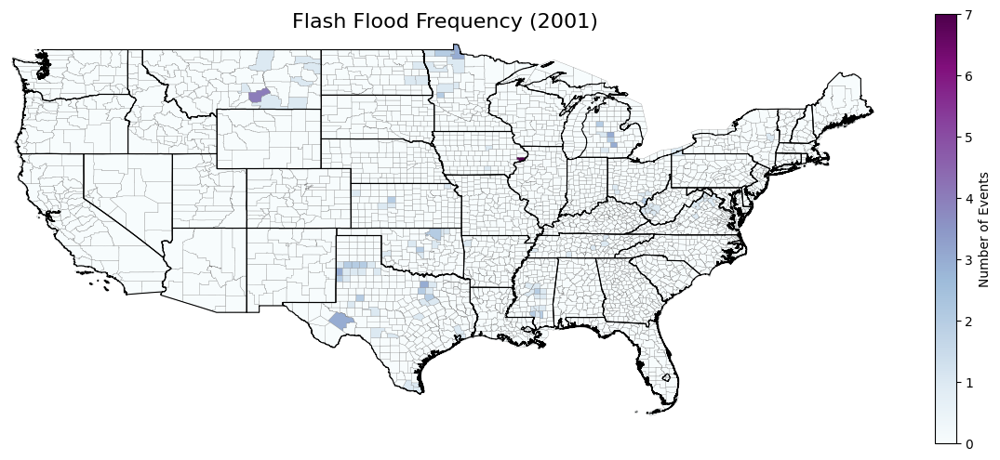

No data for Flash Flood in 2002


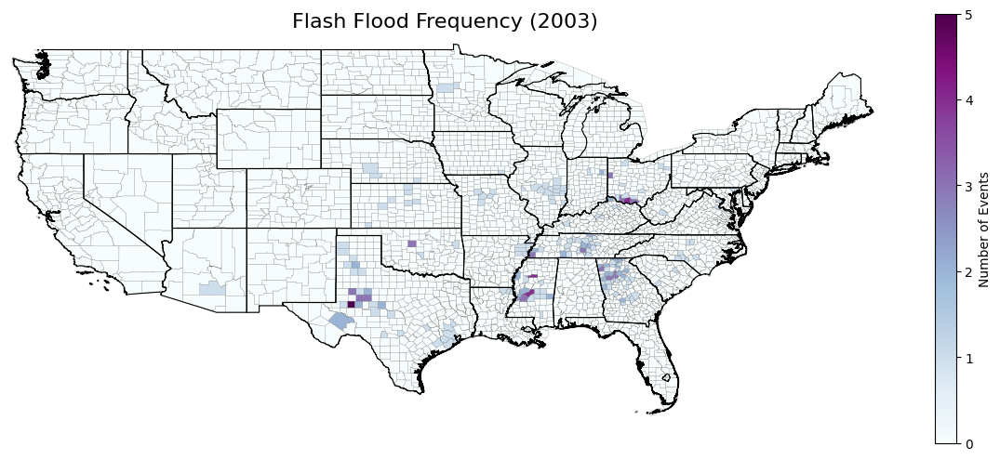

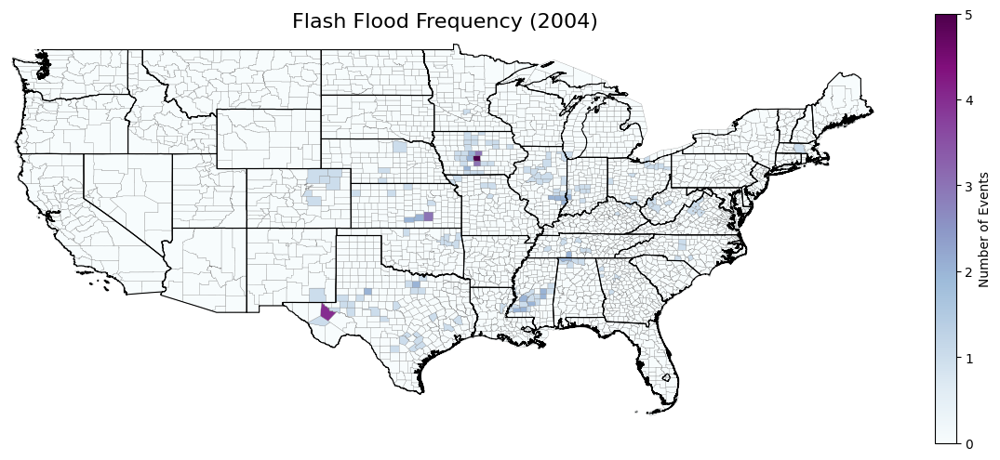

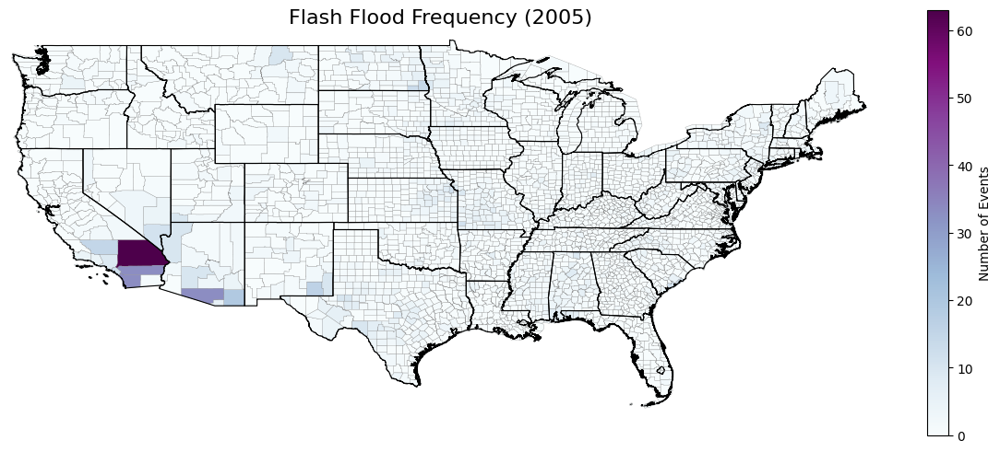

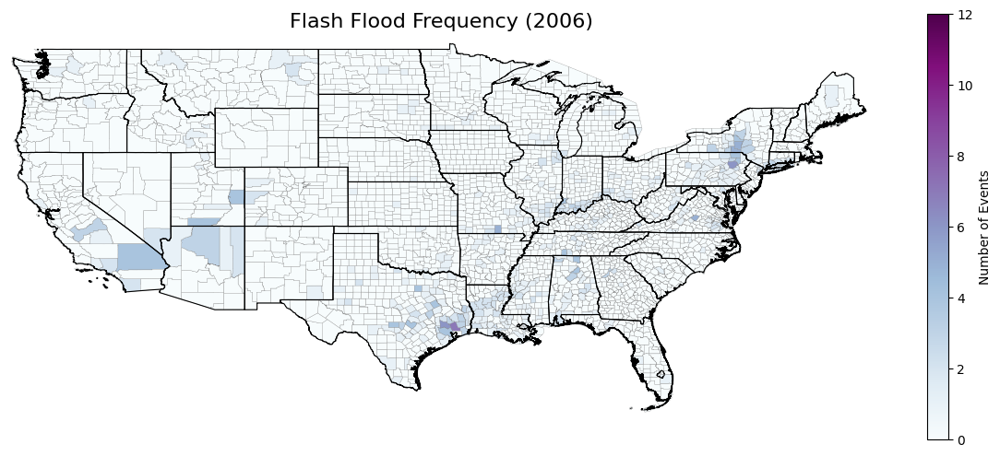

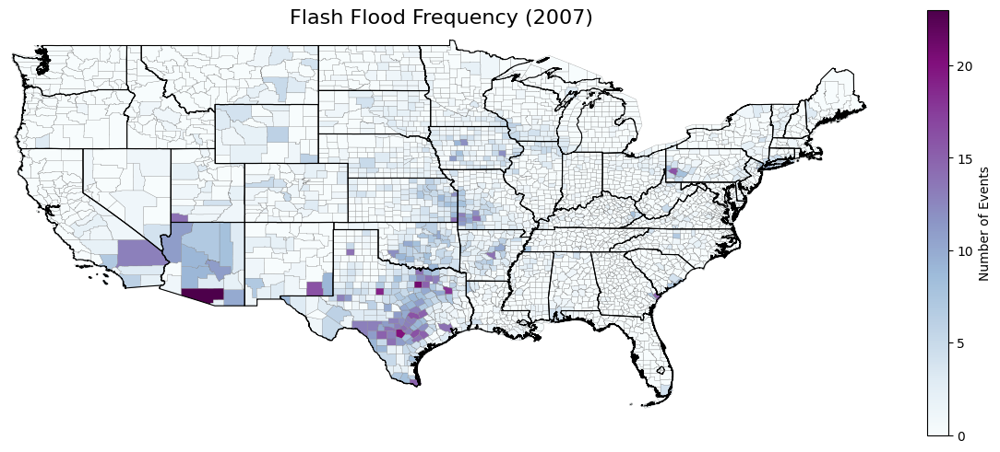

...

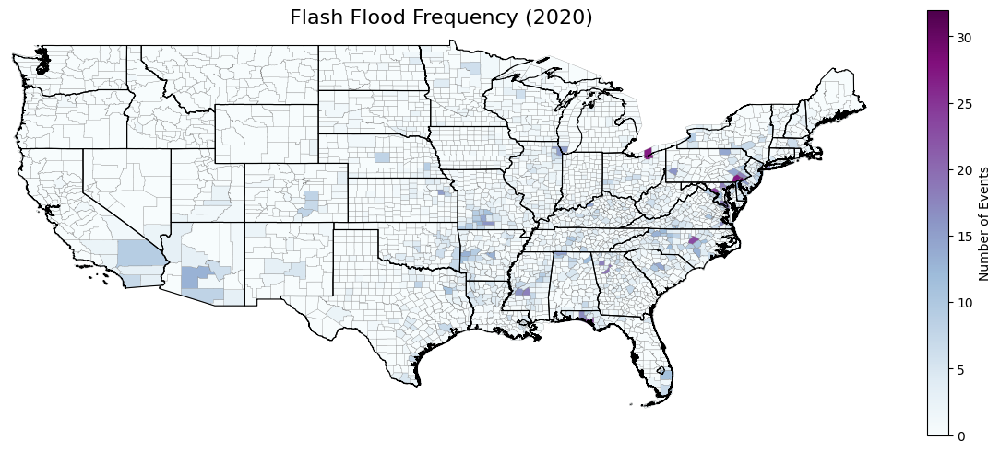

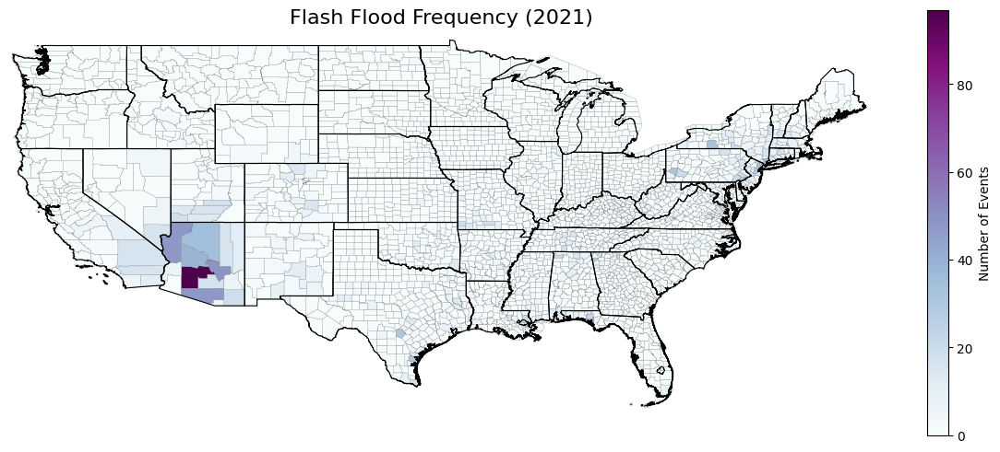

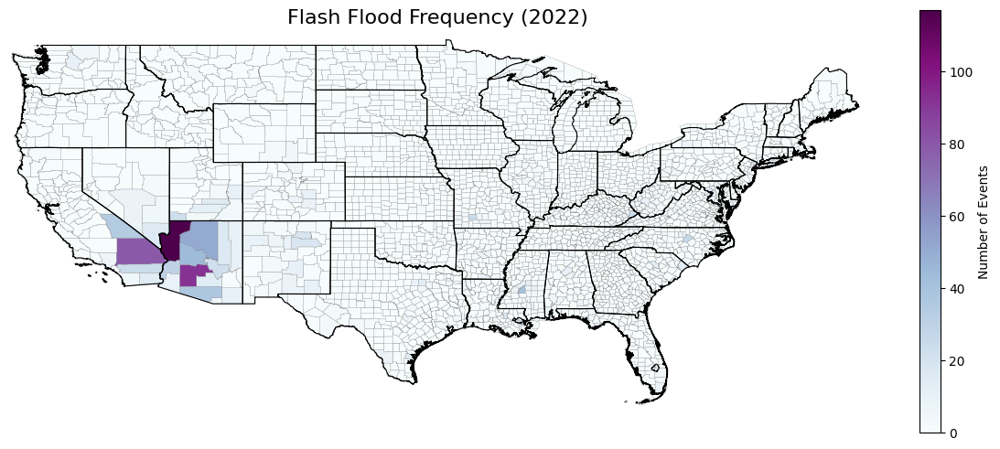

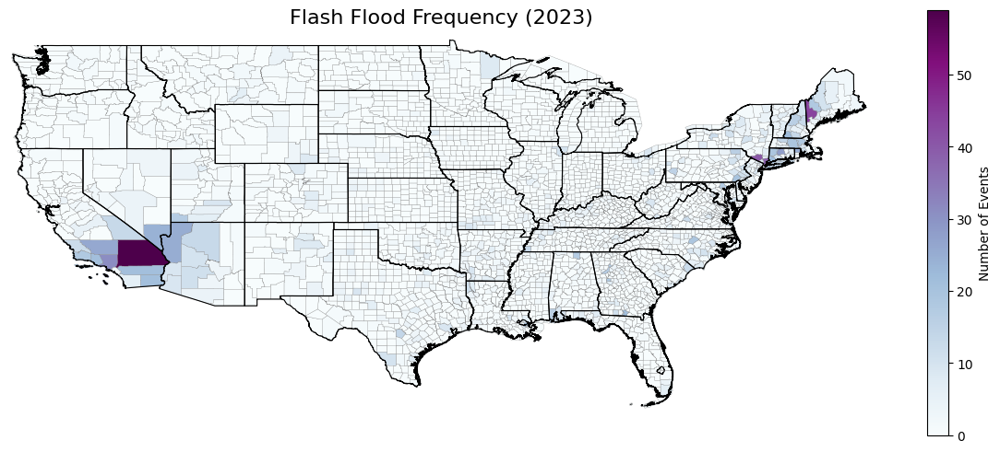

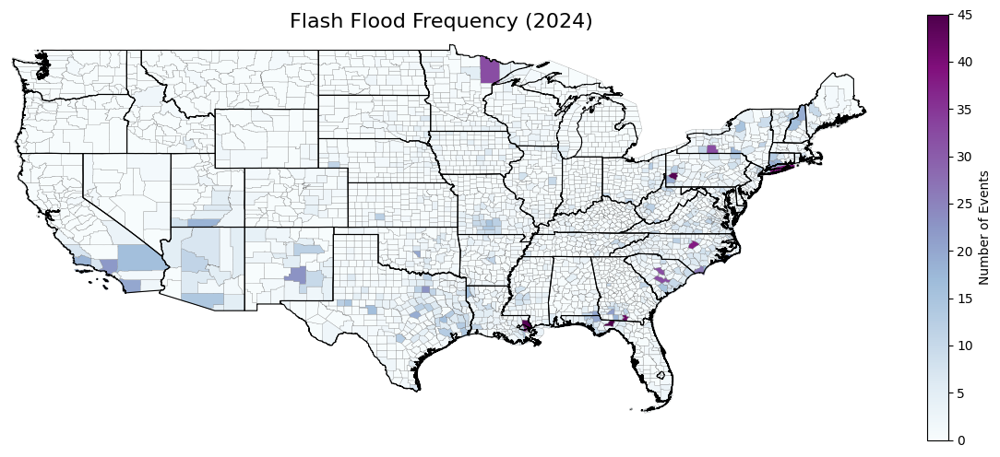

No data for Flood in 2000


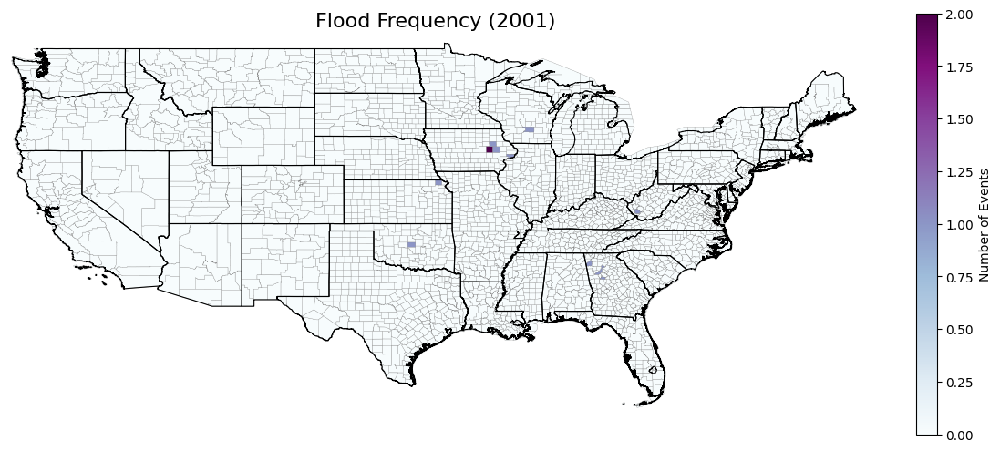

No data for Flood in 2002


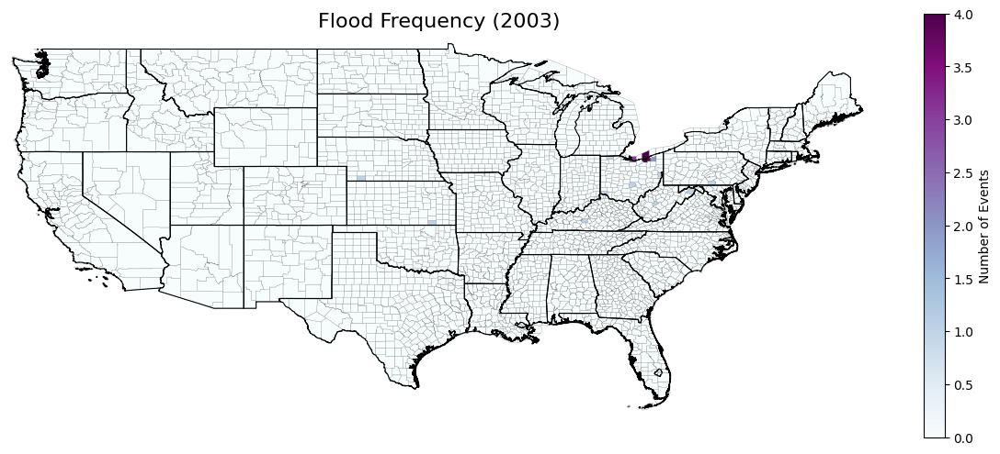

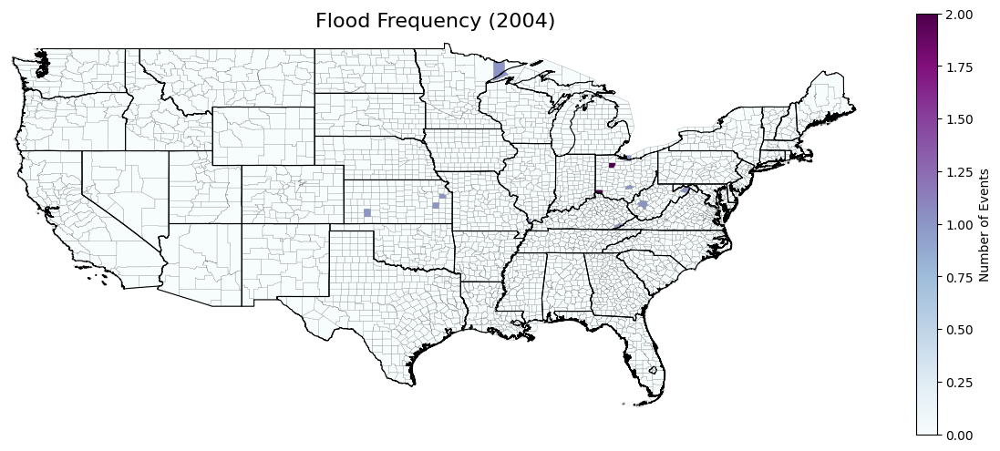

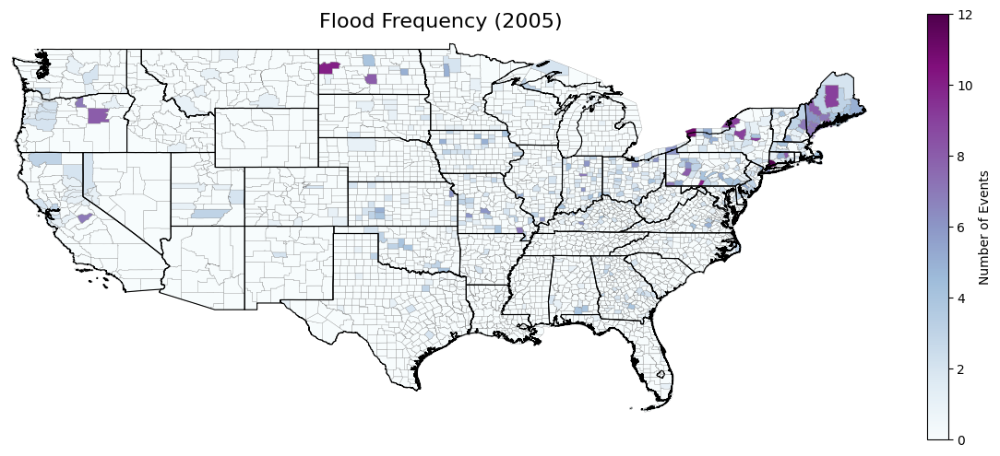

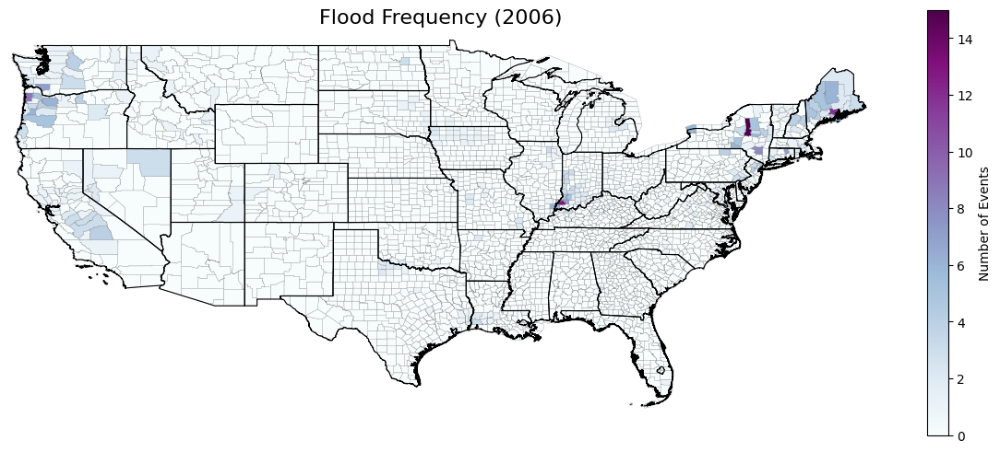

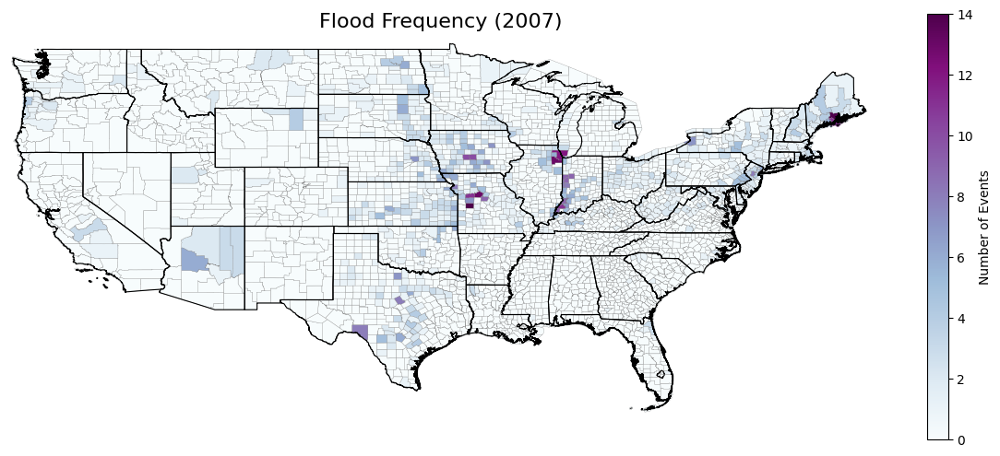

...

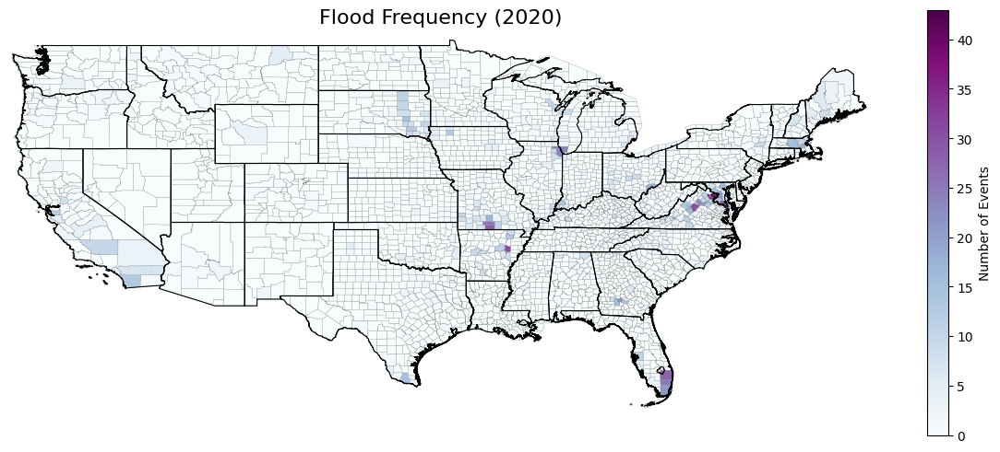

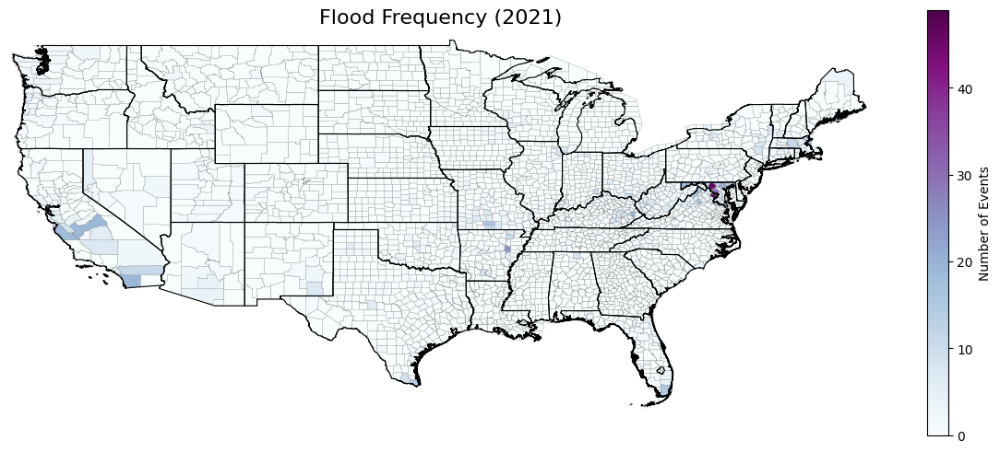

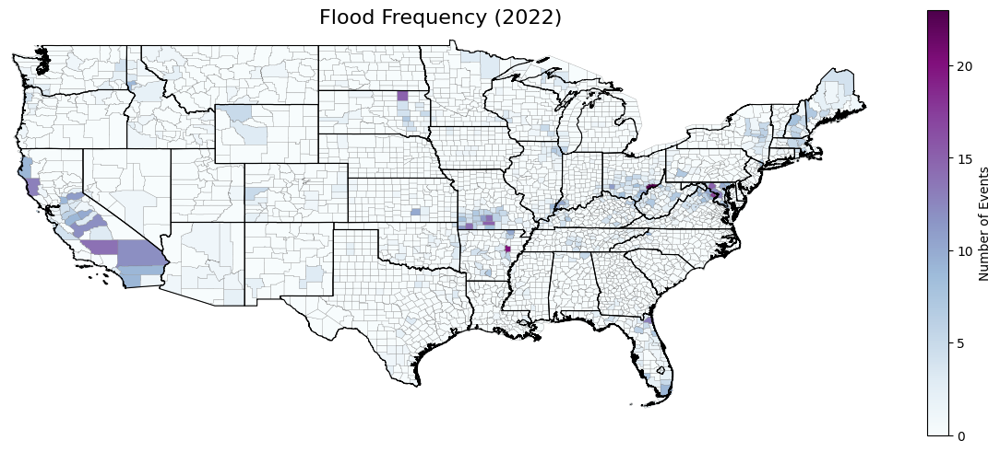

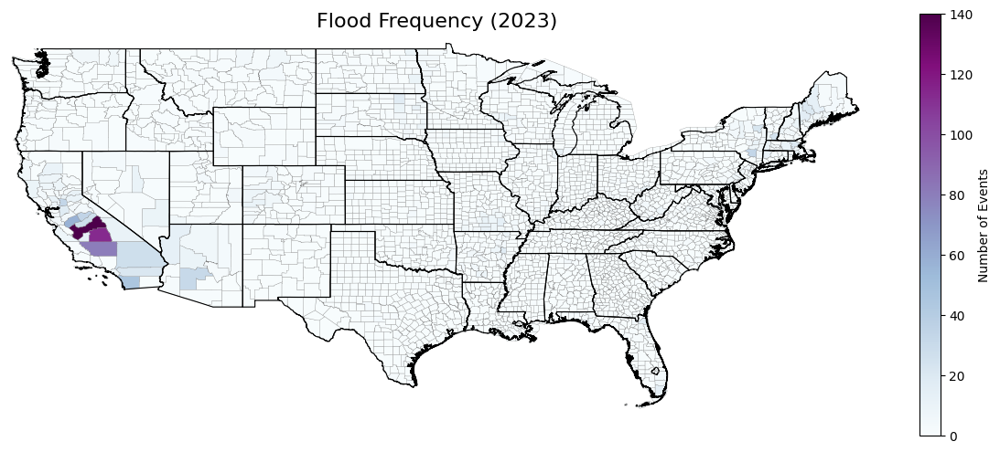

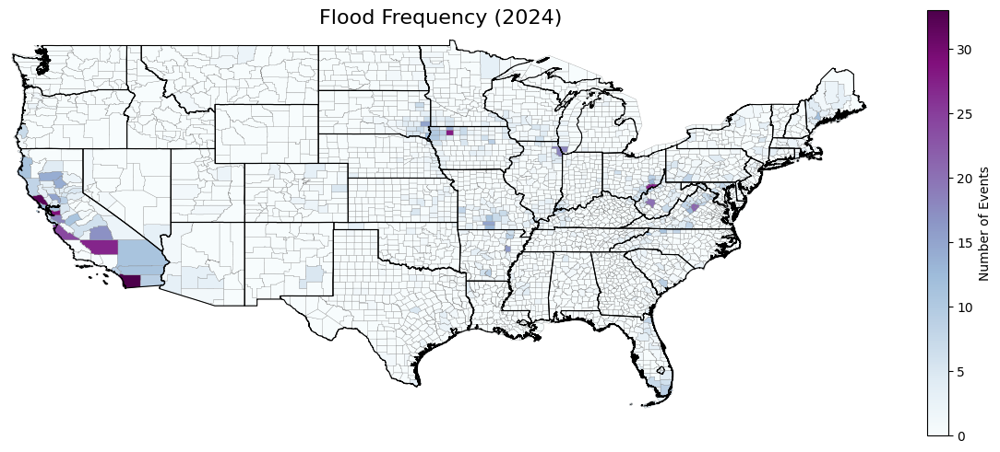

No data for Heavy Rain in 2000


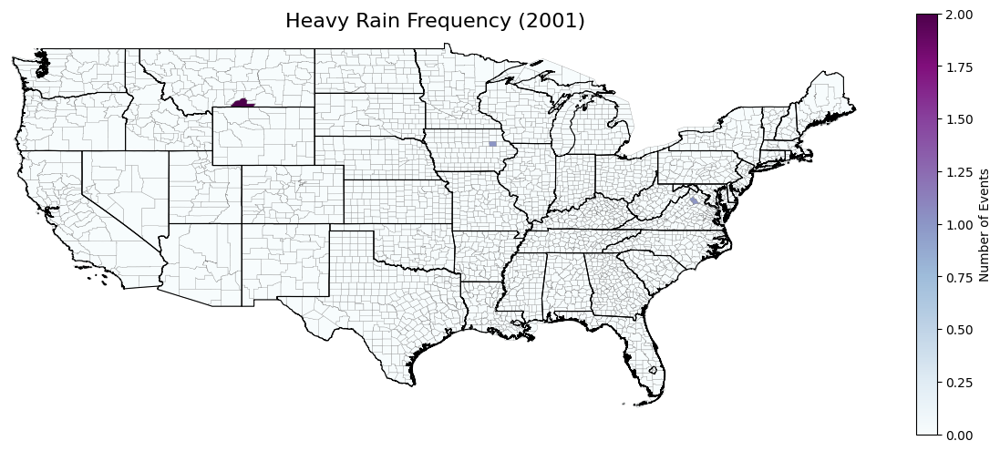

No data for Heavy Rain in 2002


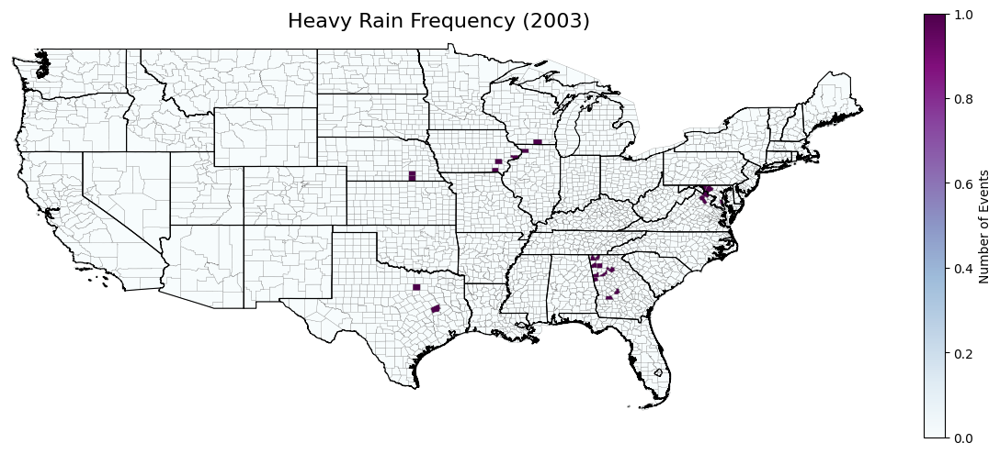

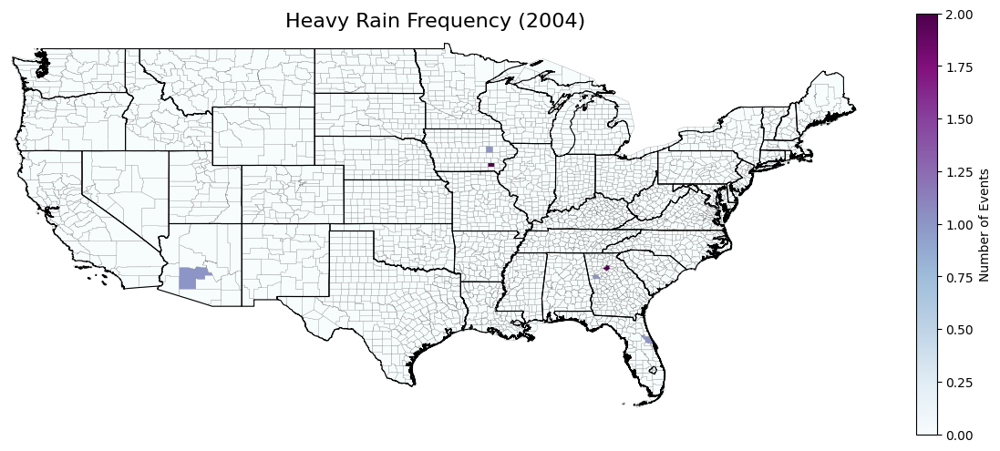

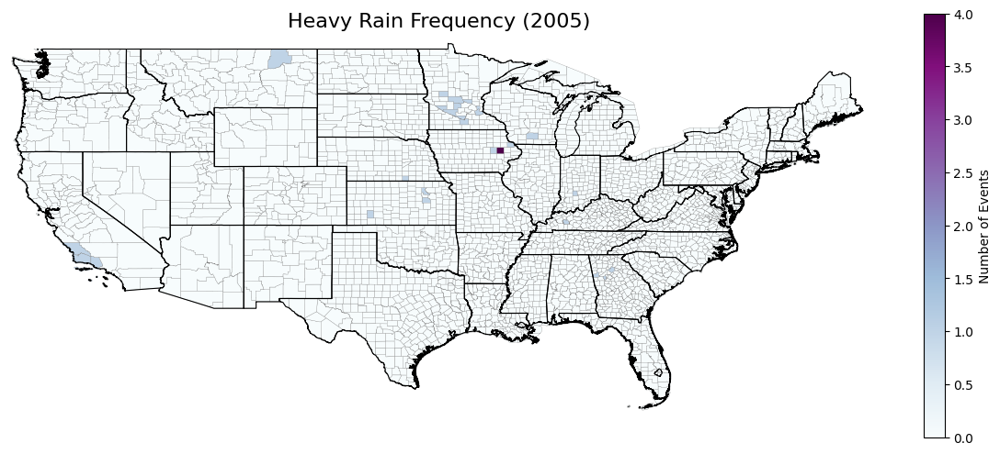

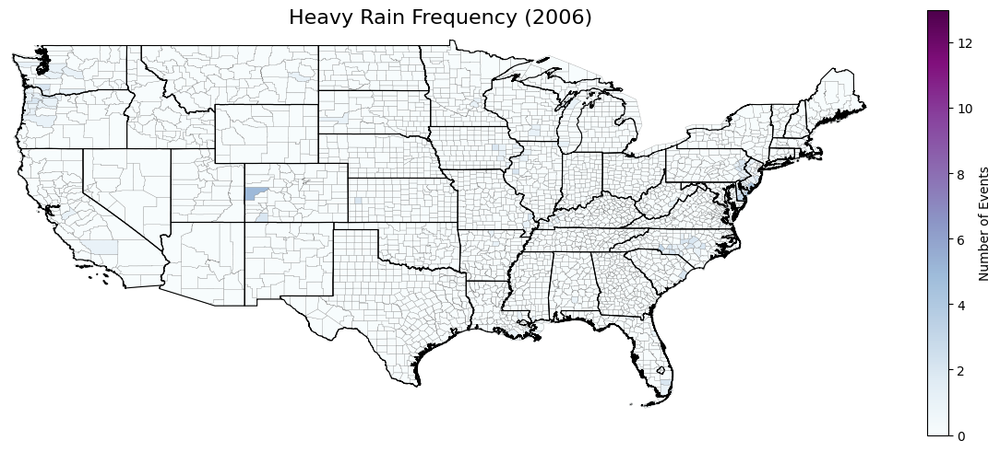

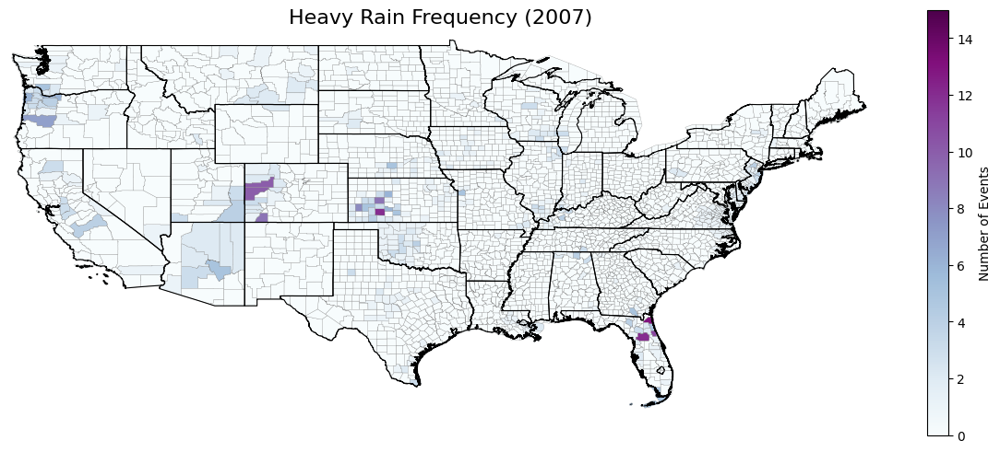

...

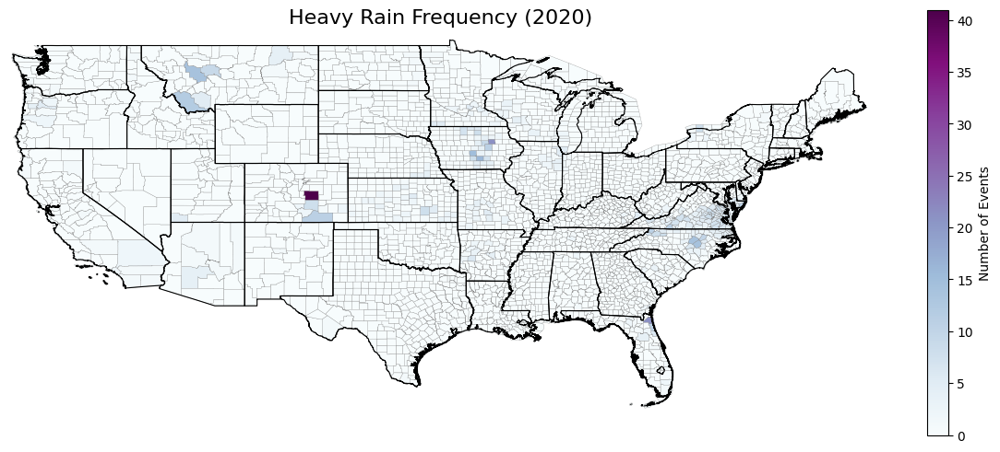

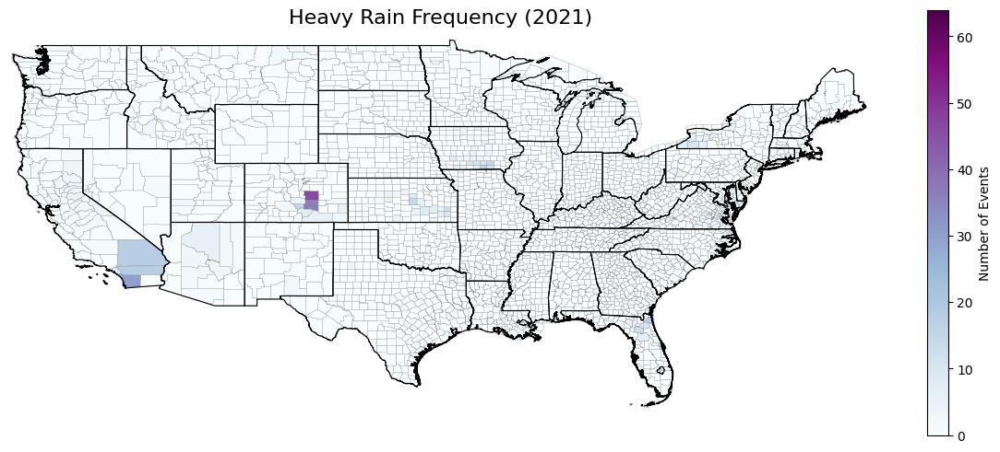

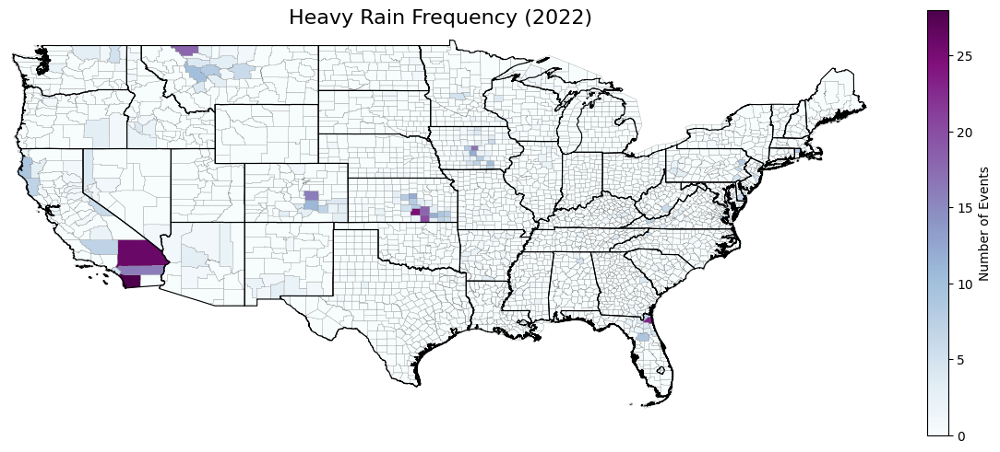

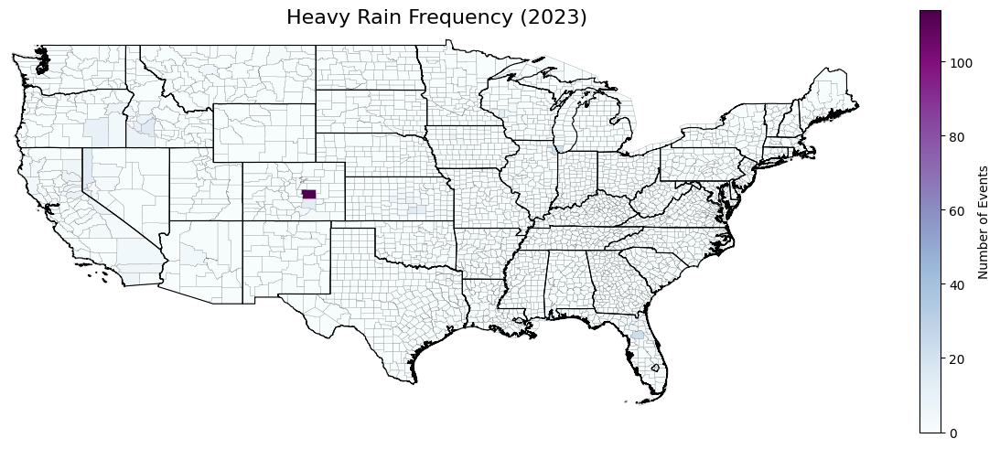

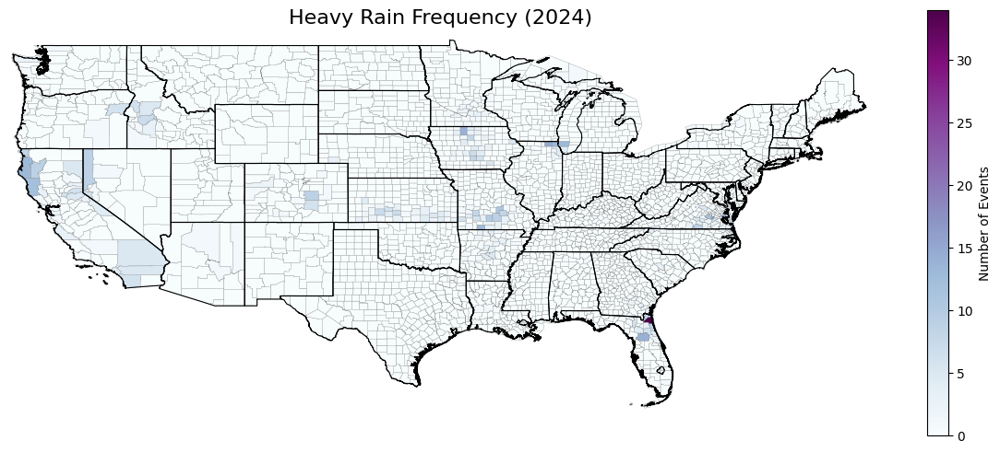

In [17]:

# Add YEAR column if missing
if 'YEAR' not in df_selected.columns:
    df_selected['YEAR'] = df_selected['BEGIN_YEARMONTH'].astype(str).str[:4].astype(int)

# CONUS parameters
CONUS_BBOX = [-125, 24, -66.5, 50]  # [minx, miny, maxx, maxy]
years = range(2000, 2025)

# Plotting loop: Events first, then years
for event in selected_events:
    for year in years:
        # Filter data for this event/year
        df_year_event = df_selected[
            (df_selected['EVENT_TYPE'] == event) &
            (df_selected['YEAR'] == year)
        ]
        
        if df_year_event.empty:
            print(f"No data for {event} in {year}")
            continue
        
        # Aggregate counts
        event_counts = (
            df_year_event.groupby('FIPS')
            .size()
            .reset_index(name='count')
        )
        
        # Merge with counties
        county_data = gdf_county.merge(
            event_counts,
            left_on='GEOID',
            right_on='FIPS',
            how='left'
        ).fillna(0)
        
        # Plot
        plt.figure(figsize=(12, 8))
        ax = plt.gca()
        county_data.plot(
            column='count',
            cmap='BuPu',
            linewidth=0.2,
            edgecolor='grey',
            legend=True,
            ax=ax,
            legend_kwds={'shrink': 0.6, 'label': 'Number of Events'}
        )
        gdf_state.boundary.plot(ax=ax, linewidth=0.8, edgecolor='black')
        ax.set_xlim(CONUS_BBOX[0], CONUS_BBOX[2])
        ax.set_ylim(CONUS_BBOX[1], CONUS_BBOX[3])
        ax.set_aspect('equal')
        ax.set_facecolor('#f5f5f5')
        plt.title(f"{event} Frequency ({year})", fontsize=16)
        plt.axis('off')
        plt.tight_layout()
        plt.show()


In [19]:
# Notes:
# combine the events frequency and damagages and everything else based on county effects
# the plots above have some counties outside the state boundary, cross check the plots
# no data available for flash floods, floods, heavy rain 2000 and before